In [16]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

import os

import librosa
import librosa.display

import seaborn as sns
sns.set_style('whitegrid')

import math

import warnings
warnings.filterwarnings("ignore")

import IPython

import sklearn
from sklearn import preprocessing
from scipy.signal import lfilter

In [4]:
# Seed initialization for random number generator to ensure reproducibility
seed = 12
np.random.seed(seed)

# Define the relative path to the data
path = "../"

# Define the path to the audio files stored according to genres
path_audio_files = path + "Data/genres_original/"

# Parameters related to Fast Fourier Transform (FFT) and hop length for audio processing
hop_length = 512 # Number of samples between successive frames
n_fft = 2048  # Number of FFTs (Fast Fourier Transforms) per frame

# Dictionary to map the genre to an integer for encoding
genre_dict = {"blues": 0, "classical": 1, "country": 2, "disco": 3,
              "hiphop": 4, "jazz": 5, "metal": 6, "pop": 7, "reggae": 8, "rock": 9}


+ **Hop Length:** The hop length defines how much we are shifting to the right (forward in time) to get the next frame to analyze. If the hop length is very small, the frames will have a lot of overlap, providing a high-resolution analysis of the signal but at a higher computational cost. If the hop length is large, the frames will have less overlap, which may result in a loss of information between frames but will be computationally cheaper.

`hop_length=512` means that librosa takes chunks (frames) of the signal and performs the FFT by shifting the window by 512 samples each time to get the next frame.

+ **FFT:** FFT is an algorithm that calculates the discrete Fourier Transform (DFT) of a sequence. In the context of audio, it helps transform the signal from the time domain to the frequency domain, revealing the different frequency components present in a signal segment (frame). <br>
**n_fft** defines the length of the windowed signal segment (frame) in which the FFT is computed. Essentially, it sets the number of bins (data points) in the FFT. Each bin represents a specific frequency, and the range of frequencies is determined by the sampling rate of the audio signal.

`n_fft=2048` means that the FFT will be calculated over 2048 samples of the signal. <br>
The choice of n_fft should be adapted to the use case:

If the focus is on capturing the precise timing of events in the audio, a smaller n_fft might be preferred.
If the focus is on identifying specific frequencies or analyzing the harmonic content, a larger n_fft might be beneficial.

Higher values of n_fft will result in higher frequency resolution in the spectrogram, but the downside is that the analysis will be slower. <br>
The sample rate (or sampling rate) is the number of samples taken per second. The units for sample rate are samples per second (sps) or Hertz (Hz). For the GTZAN dataset, the sample rate is 22050 Hz which means that 22050 samples are taken per second.
By default, librosa uses a value of 2048 for n_fft, which is 93.75 ms for a sampling rate of 22050 Hz.


In [5]:
for genre in genre_dict.keys():
    print(genre)
    # Loading the first audio file of the current genre using librosa
    data, sampling_rate = librosa.load(
        path_audio_files + genre + "/" + genre + ".00000.wav")
    # Displaying an interactive audio player to listen to the loaded audio file
    # using IPython's display.Audio() function
    display(IPython.display.Audio(data, rate=sampling_rate))
print("Sampling rate: ", sampling_rate)


blues


classical


country


disco


hiphop


jazz


metal


pop


reggae


rock


Sampling rate:  22050


# Audio Visualization

### Pre-emphasis filter 
A pre-emphasis filter is useful in several ways: 
- It balances the frequency spectrum since high frequencies usually have smaller magnitudes compared to lower frequencies.
- By applying a pre-emphasis filter, you emphasize or boost the amplitudes of high-frequency components in the signal. This can enhance the clarity of high-frequency details in the audio.
- It helps avoid numerical problems during the Fourier transform operation 
- It may also improve the Signal-to-Noise Ratio (SNR).

$$y(t) = y(t) − α y(t−1)$$

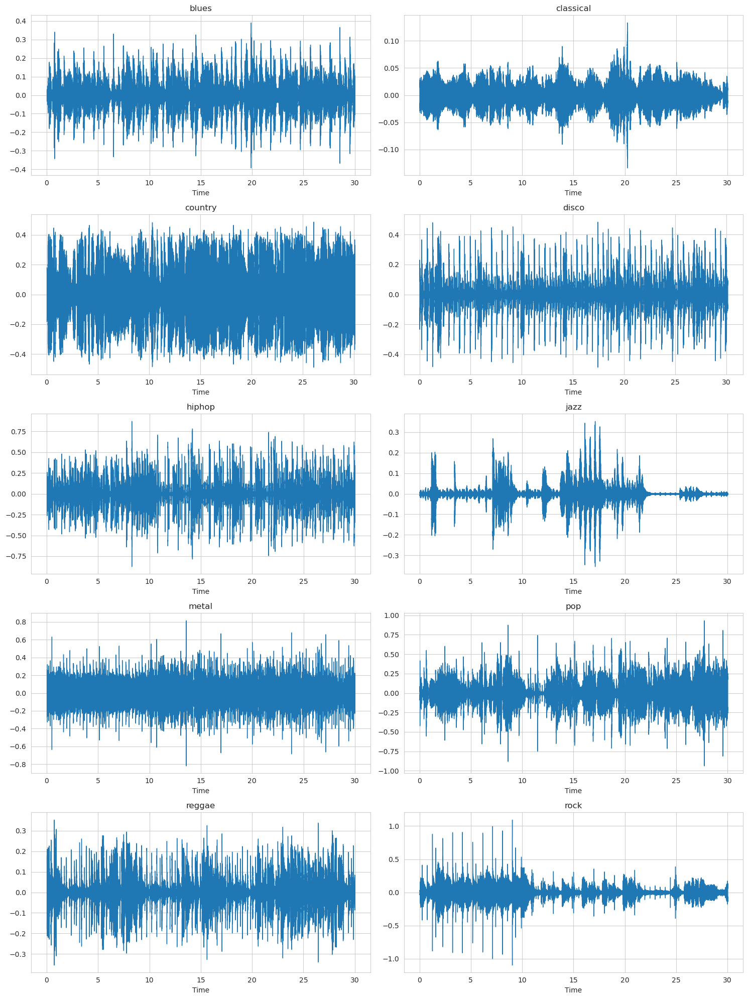

In [19]:
# Define the pre-emphasis filter coefficient (typically around 0.95)
pre_emphasis = 0.97

# Create subplots
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))

for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Loading the audio file
    data, sampling_rate = librosa.load(f"{path_audio_files}{genre}/{genre}.00000.wav")
    
    # Apply pre-emphasis to the audio signal
    data_emphasized = lfilter([1, -pre_emphasis], 1, data)
    librosa.display.waveshow(data_emphasized, sr=sampling_rate, ax=ax)
    ax.set(title=f"{genre}")
    

plt.tight_layout()
plt.show()


### Amplitude vs Time
Amplitude is an important Time Domain feature that can be used to distinguish between different genres. For example, classical music tends to have a higher amplitude than jazz.
Central moments: This consists of the mean, standard deviation, skewness and kurtosis of the amplitude of the signal.

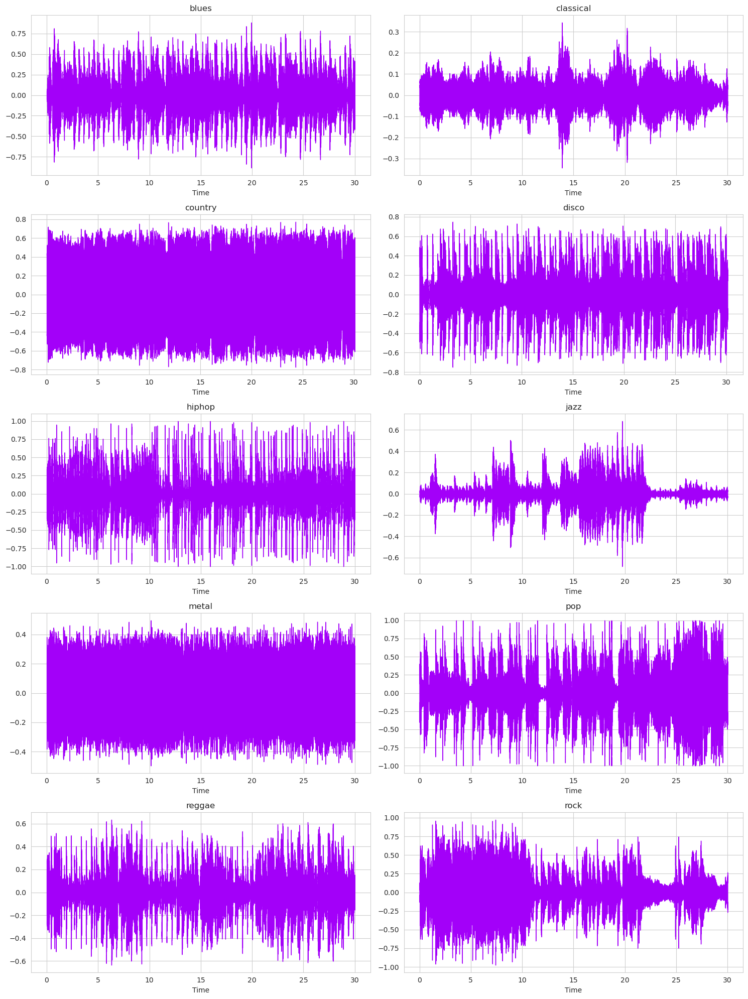

In [14]:
# Setup a 5x2 grid of plots (subplots)
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))

# Enumerate over genres and axes.flat to avoid dealing with the 2D axes array
# Also avoiding manual index management (i, j)
for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Loading the audio file
    data, sampling_rate = librosa.load(f"{path_audio_files}{genre}/{genre}.00000.wav")
    
    # Displaying the waveform on the respective subplot (ax)
    librosa.display.waveshow(y=data, sr=sampling_rate, color="#A300F9", ax=ax)
    
    # Setting the title for each subplot
    ax.set_title(genre)

# Adjusting the layout to prevent overlap and display the plot
plt.tight_layout()
plt.show()

### Zero Crossing Rate (ZCR)
Zero-crossing rate is the rate at which the signal changes from positive to negative or vice versa.
+ High zero-crossing rates may indicate percussive sounds (like drums or hand claps).
+ Vocal sounds (speech and singing) tend to have higher zero-crossing rates during voiced (vibration of vocal folds) segments, and lower during unvoiced segments.

A single increment in X-axis represents a single frame of the audio signal. The Y-axis represents the zero-crossing rate of the signal in that frame. For the current example, the zero-crossing rate is calculated over a frame of 2048 samples with a hop length of 512 samples.

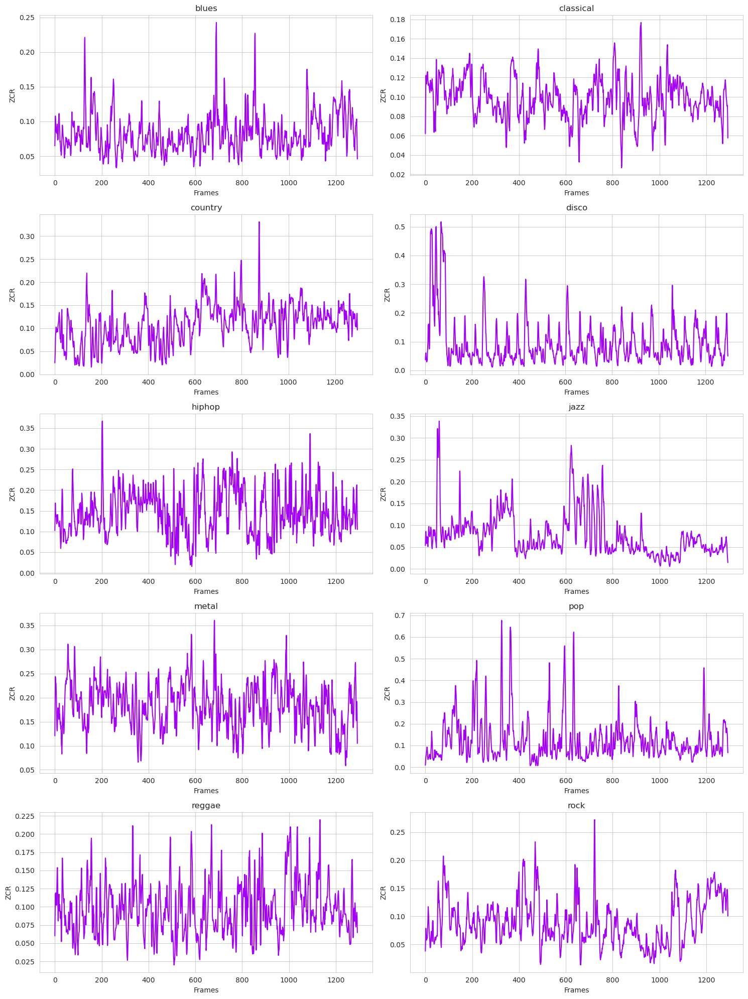

In [13]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))

for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Loading the audio file
    data, sampling_rate = librosa.load(f"{path_audio_files}{genre}/{genre}.00000.wav")
    # Compute the Zero Crossing Rate (ZCR) of the audio data
    zero_crossing_rate = librosa.feature.zero_crossing_rate(y = data,hop_length = hop_length)[0]
    ax.set_xlabel("Frames")
    ax.set_ylabel("ZCR")
    # Setting the title for each subplot
    ax.set_title(genre)
    # Displaying the ZCR on the respective subplot (ax)
    ax.plot(zero_crossing_rate, color="#A300F9")  

plt.tight_layout()
plt.show()

### STFT (Short Time Fourier Transforms)
The Short-Time Fourier Transform (STFT) is a widely-used technique in signal processing to analyze the frequency content of a signal, especially when its frequency characteristics are varying over time.
The STFT is computed by sliding a window over the signal and calculating the FFT for each windowed segment. The FFT is calculated for each windowed segment by multiplying the signal segment with a window function (such as the Hann window) to analyze short segments of signal, and then zero-padding it to the nearest power of two to improve computational efficiency.

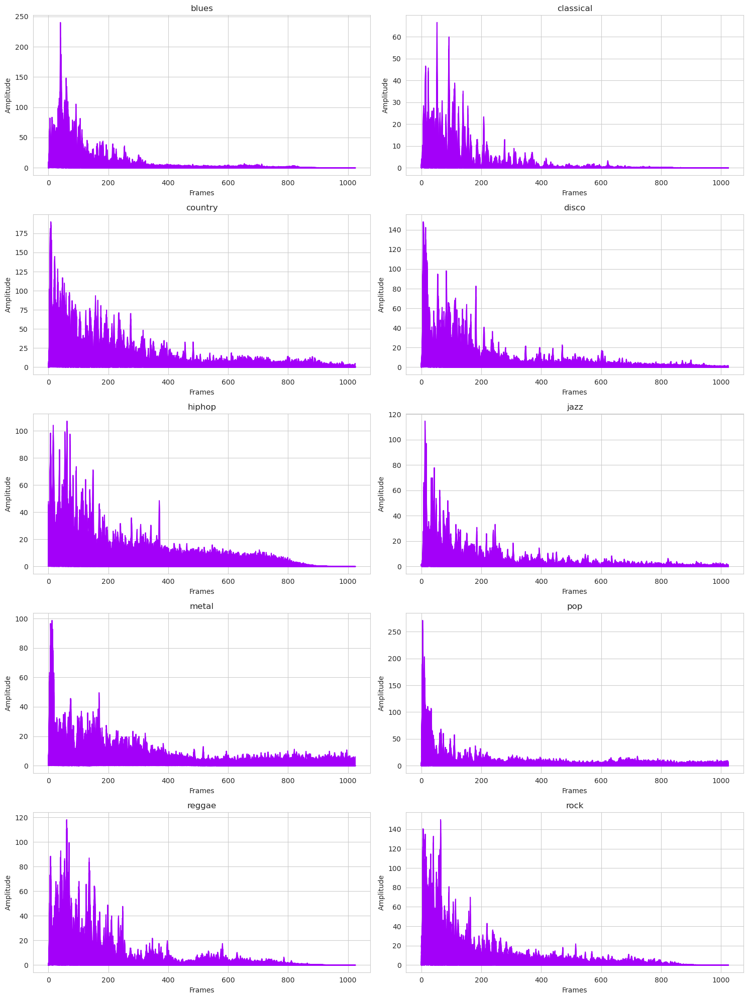

In [16]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    # Calculating the Short-Time Fourier Transform (STFT) of the audio signal
    # We take the absolute value of the STFT to get the magnitude and not the phase
    stft_data = np.abs(librosa.stft(y = data, n_fft = n_fft,hop_length = hop_length))
    ax.plot(stft_data,color = "#A300F9")
    ax.set_title(genre)

plt.tight_layout()
plt.show()

### Spectrogram

+ The STFT produces a complex-valued spectrogram, which shows how the amplitude and phase of different frequency components change over time. The complex spectrogram S is computed for each time frame t and each frequency bin f as S[f, t].

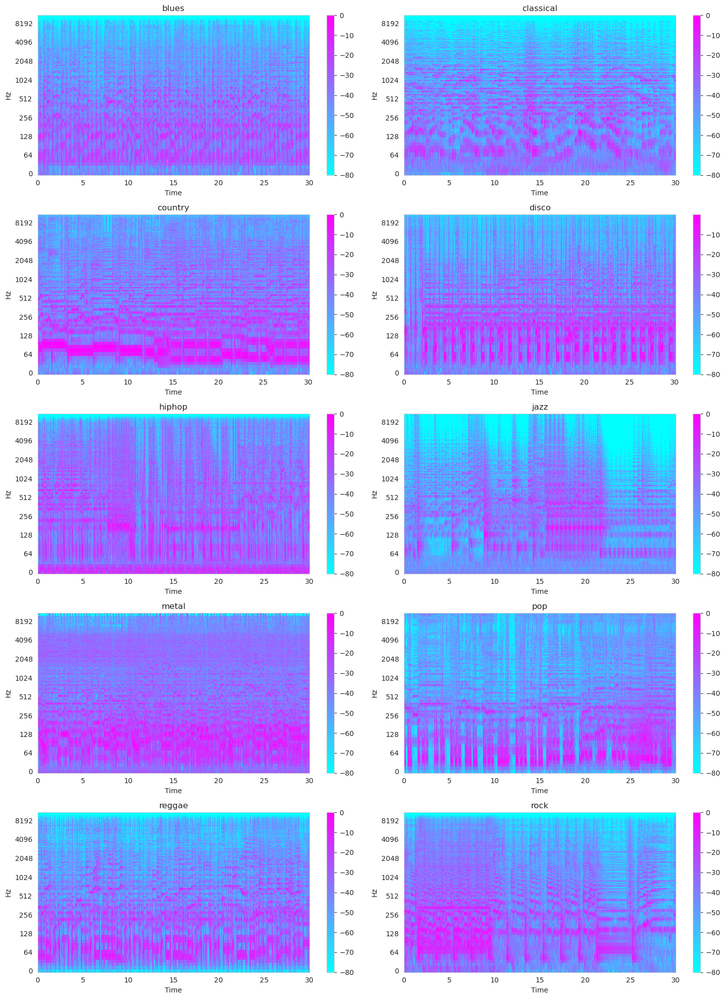

In [17]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")    
    stft_data = np.abs(librosa.stft(y = data, n_fft = n_fft,hop_length = hop_length))
    # Convert an amplitude spectrogram to Decibels-scaled spectrogram.
    DB = librosa.amplitude_to_db(stft_data, ref = np.max)
    # Displaying the spectrogram on the respective subplot (ax)
    img = librosa.display.specshow(DB, sr = sampling_rate, hop_length = hop_length, x_axis = 'time', y_axis = 'log',cmap = 'cool',ax=ax)
    fig.colorbar(img, ax=ax)    
    ax.set_title(genre)

plt.tight_layout()
plt.show()

### Mel Spectrogram
A Mel Spectrogram is a representation of a sound that depicts how the power spectrum of a signal is distributed across different frequency bands on the Mel scale. This is especially significant in the realm of audio processing and speech recognition because the Mel scale more closely approximates the human ear's response to different frequencies, making it a more perceptually relevant representation of audio signals.

+ **Mel Scale:** It is a perceptual scale of pitches where equal distances between points sound equidistant to the human ear.
+ **Spectrogram:** A visual representation of the spectrum of frequencies in a sound signal as they vary with time.
+ **Mel Spectrogram:** A Mel Spectrogram is a spectrogram where the frequencies are converted to the Mel scale.

#### Steps to Compute Mel Spectrogram:
1. **STFT:** Compute the Short-Time Fourier Transform (STFT) to get a spectrogram, which gives a magnitude value for frequency bins across time.

2. **Mel Filter Bank:** Create a filter bank matrix to convert the frequency representation obtained via STFT to the Mel scale. This involves mapping the power spectrum obtained from STFT onto an array of Mel filters (usually triangular filters).

3. **Apply Mel Filter Bank:** Multiply the STFT of the signal by the Mel filter bank.

4. **Log Compression:** Finally, apply logarithmic compression.

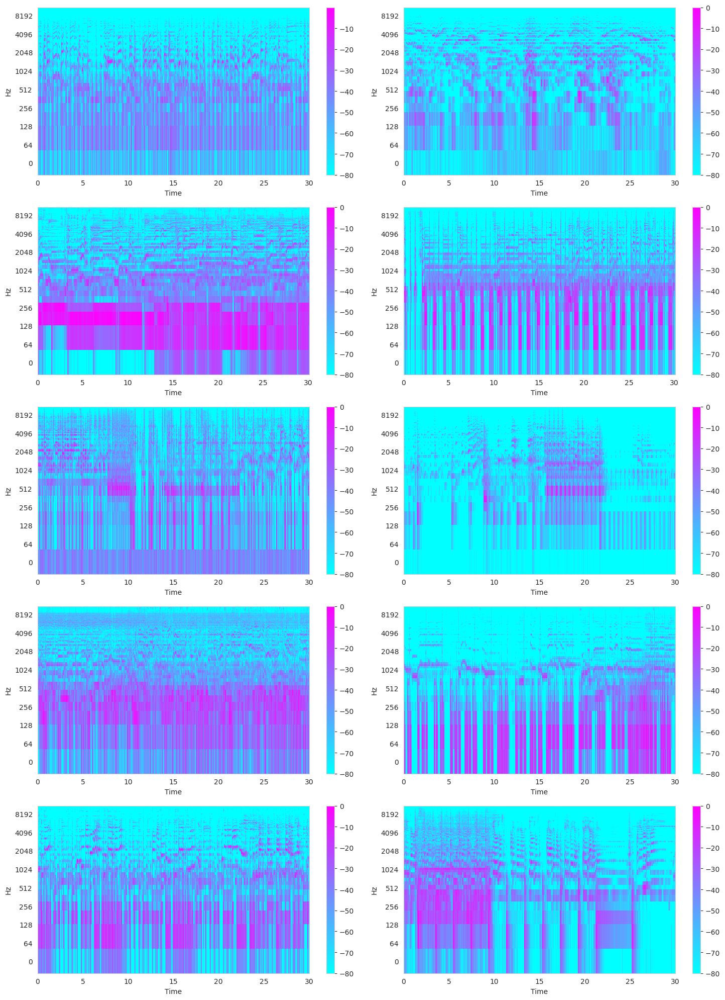

In [18]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    # Calculating the Mel Spectrogram
    mel_spec = librosa.feature.melspectrogram(y=data, sr=sampling_rate,hop_length = hop_length)
    # Converting the Mel Spectrogram to Decibels-scaled Spectrogram
    mel_spec_db = librosa.amplitude_to_db(mel_spec, ref=np.max)
    # Displaying the spectrogram on the respective subplot (ax)
    img = librosa.display.specshow(mel_spec_db, sr = sampling_rate, hop_length = hop_length, x_axis = 'time', y_axis = 'log',cmap = 'cool',ax=ax)
    fig.colorbar(img, ax=ax)

plt.tight_layout()
plt.show()

### Mel Frequency Cepstral Coefficients
Mel Frequency Cepstral Coefficients (MFCCs) are a type of spectral representation used in speech and speaker recognition, due to their capability to represent the speech amplitude spectrum in a compact form. It is derived from the Mel Spectrogram by applying Discrete Cosine Transform (DCT) to the log Mel spectra, reducing the feature dimensions and emphasizing the amplitudes of the spectrum.

#### Steps to Compute Mel Spectrogram:
1. **Fourier Transform:** Compute the Fourier Transform to transform the frames from time domain to frequency domain.

2. **Mel Filter Bank:** Create a filter bank matrix to convert the frequency representation obtained via STFT to the Mel scale. This involves mapping the power spectrum obtained from STFT onto an array of Mel filters (usually triangular filters).

3. **Apply Mel Filter Bank:** Multiply the STFT of the signal by the Mel filter bank.

4. **Discrete Cosine Transform (DCT):** Take the DCT of the logarithm of all filter bank energies to decorrelate the energies and yield a set of cepstral coefficients.

5. **Keep DCT Coefficients:** Retain a subset of the DCT coefficients. The lower-order coefficients represent the slowly varying (smooth) part of the input signal, and typically 12-13 coefficients are kept.

+ MFCCs typically have lower dimensionality compared to Mel Spectrograms due to the application of the DCT and keeping a limited number of coefficients.
+ Deep learning models (like CNNs) might prefer Mel Spectrograms as inputs since they can learn hierarchical features from the spectrogram images, while traditional models (like GMMs, HMMs) often use MFCCs due to their lower dimensionality and computational efficiency.
+ While MFCCs are compact and hold essential information about the original signal, Mel Spectrograms tend to preserve more fine-grained details about the spectral information and are richer in representation.

MFCC data shape for blues: (20, 1293)
MFCC data for blues: [[240.63542    211.21436    193.90889    ... 109.999146    86.81442
   84.073586  ]
 [ 99.647644   101.04283    102.243965   ... 150.07935    138.94867
  138.30977   ]
 [  7.4032745    8.358526     1.9154336  ...  50.795135    36.536144
   28.136356  ]
 ...
 [  9.741491     6.3694725    3.650028   ...   2.857153     6.2137356
    0.49142838]
 [  3.5908704    4.0508466    4.7889986  ...   7.5746884    8.446721
    6.7805653 ]
 [  5.348016     3.231847     0.9402473  ...   7.555337     0.30611205
    3.5234969 ]]
MFCC data shape for classical: (20, 1293)
MFCC data for classical: [[2.82499908e+02 2.60804260e+02 2.72117126e+02 ... 3.07149048e+02
  3.13038300e+02 3.05962128e+02]
 [1.14519684e+02 1.17253036e+02 1.19419052e+02 ... 1.34084930e+02
  1.33719086e+02 1.24817833e+02]
 [2.68702793e+01 3.11253357e+01 2.91280499e+01 ... 1.70843887e+01
  1.59621916e+01 1.17607727e+01]
 ...
 [7.56599998e+00 6.68328238e+00 4.44708586e+00 ... 5.92

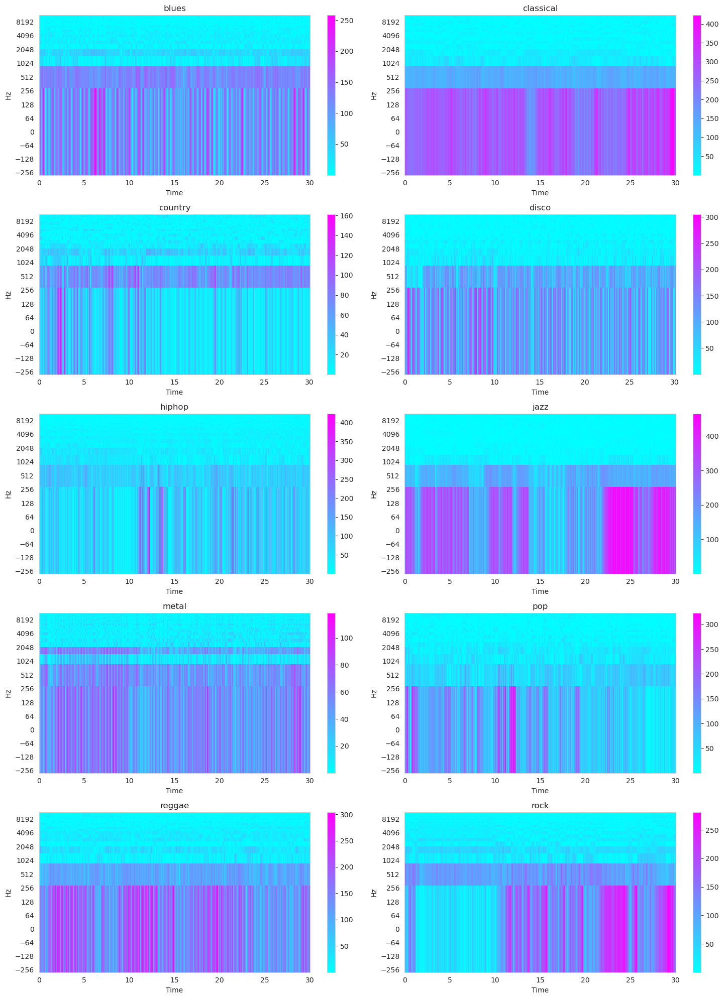

In [20]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    mfcc_data = np.abs(librosa.feature.mfcc(y = data, sr = sampling_rate))
    print(f"MFCC data shape for {genre}: {mfcc_data.shape}")
    print(f"MFCC data for {genre}: {mfcc_data}")

    img = librosa.display.specshow(mfcc_data, sr = sampling_rate, x_axis = 'time', y_axis = 'log',cmap = 'cool',ax=ax)
    fig.colorbar(img, ax=ax)
    ax.set_title(genre)

plt.tight_layout()
plt.show()

+ MFCC coefficients contain information about the rate changes in the different spectrum bands.
+ If a cepstral coefficient has a positive value, the majority of the spectral energy is concentrated in the low-frequency regions. On the other hand, if a cepstral coefficient has a negative value, it represents that most of the spectral energy is concentrated at high frequencies.

### Chromagram
Chromagram sequence of chroma features each expressing how the representation's pitch content within the time window is spread over the twelve chroma bands/pitches classes. 

The process to compute a Chromagram involves several steps:

1. **STFT:** Compute the Short-Time Fourier Transform (STFT) of the audio signal to obtain a spectrogram. This represents the energy distribution across different frequencies over time.

2. **Mapping to Pitch:** Map the frequency values from the spectrogram to the corresponding pitch classes. This is done by applying a constant-Q transform, which maps the frequencies to the 12 chroma bins (notes).

3. **Chroma Energy:** Calculate the energy or magnitude in each of the 12 chroma bins for each frame of the audio.

4. **Normalization:** Normalize the energy in each chroma bin to sum to 1 for each frame. This step ensures that the chroma vector represents relative pitch intensities rather than absolute energy.

#### What is a Pitch?
Pitch is a fundamental attribute of sound. It is a perceptual quality of sound that allows us to differentiate between high and low tones. Pitch is how we perceive the "highness" or "lowness" of a musical note or a spoken word.

+ **Frequency:** Pitch is closely related to the frequency of a sound wave. Higher-pitched sounds have higher frequencies, while lower-pitched sounds have lower frequencies.
+ **Octaves:**  It refers to a specific interval between two musical pitches or frequencies. Pitch can be organized into octaves, with each octave doubling in frequency. For example, the pitch "A4" is one octave higher than "A3," and it has twice the frequency.
+ **Pitch Classes:** Pitch classes represent the set of all pitches in an octave. There are 12 pitch classes in an octave, and they correspond to the 12 different notes in the chromatic scale.

The 12 pitch classes in an octave are as follows:

1. C (C# or Db)
2. C#/Db (D or Eb)
3. D (D# or Eb)
4. D#/Eb (E or Fb)
5. E (F or E#)
6. F (F# or Gb)
7. F#/Gb (G or Ab)
8. G (G# or Ab)
9. G#/Ab (A or Bb)
10. A (A# or Bb)
11. A#/Bb (B or Cb)
12. B (C or B#)

+ **Doubling of Frequency:** Going up by one octave means doubling the frequency of a musical note. For example, if you have a note with a frequency of 440 Hz (like the A4 note), going up by one octave would result in a note with a frequency of 880 Hz (A5).

+ **Halving of Frequency:** Conversely, going down by one octave means halving the frequency of a musical note. If you start with a note at 440 Hz (A4), going down by one octave leads to a frequency of 220 Hz (A3).


Chromogram shape: (12, 1293)
Chromogram shape: (12, 1293)
Chromogram shape: (12, 1296)
Chromogram shape: (12, 1298)
Chromogram shape: (12, 1293)
Chromogram shape: (12, 1293)
Chromogram shape: (12, 1293)
Chromogram shape: (12, 1293)
Chromogram shape: (12, 1293)
Chromogram shape: (12, 1293)


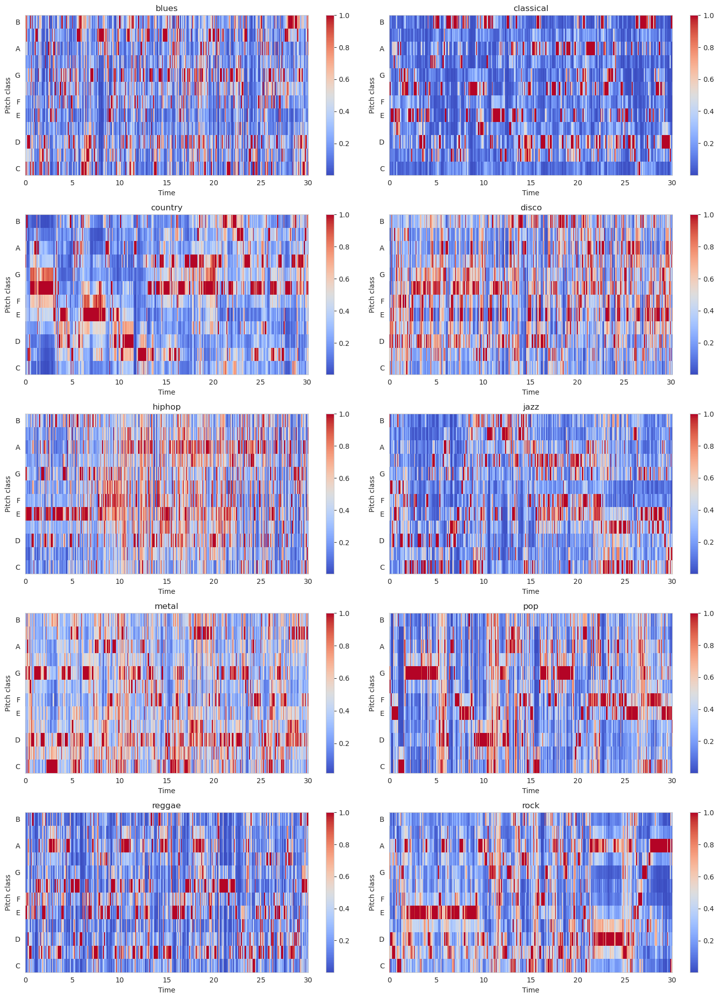

In [6]:
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Reading the first audio file
    data, sampling_rate = librosa.load(
        path_audio_files + genre + "/" + genre + ".00000.wav")
    # Chromogram
    chromagram = librosa.feature.chroma_stft(
        y=data, sr=sampling_rate, hop_length=hop_length)
    # print('Chromogram shape:', chromagram.shape)
    img = librosa.display.specshow(
        chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm', ax=ax)
    fig.colorbar(img, ax=ax)
    ax.set_title(genre)

plt.tight_layout()
plt.show()

### Spectral Centroids
Spectral Centroid characterizes the "center of mass" or the "balance point" of a sound's spectrum. It provides information about where the center of spectral content lies in terms of frequency, helping to describe the timbral or tonal characteristics of a sound.

1. **Calculation:** The spectral centroid is calculated by taking the weighted mean of the frequencies present in the spectrum of an audio signal. It's computed using the formula:
$$
Spectral\ Centroid (SC) = Σ(Freq[i] * Mag[i]) / ΣMag[i]
$$
Where:

+ $Freq[i]$ is the frequency of the i-th bin in the spectrum.
+ $Mag[i]$ is the magnitude (amplitude) of the signal in that bin.

2. **Interpretation:** The spectral centroid provides information about the "brightness" or "tonal color" of a sound. A high spectral centroid value indicates a brighter sound with more high-frequency content, while a low value suggests a darker sound with more low-frequency content.

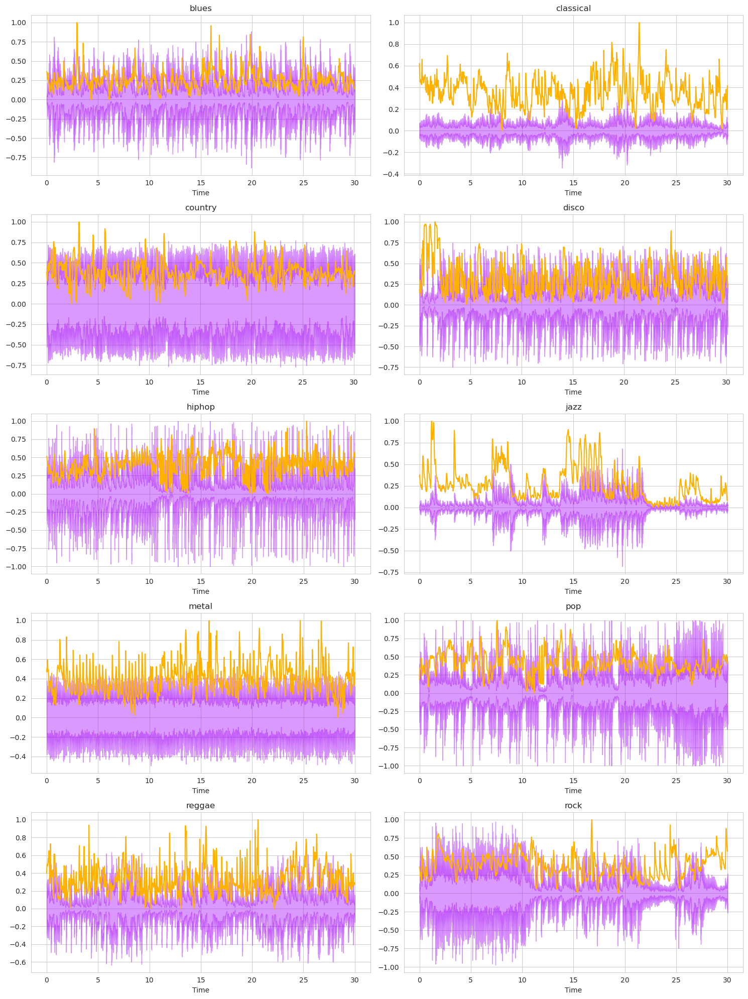

In [7]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    spectral_centroids = librosa.feature.spectral_centroid(y=data, sr=sampling_rate)[0]
    # Computing the time variable for visualization
    frames = range(len(spectral_centroids))
    # Converts frame counts to time (seconds)
    t = librosa.frames_to_time(frames)
    librosa.display.waveshow(data, sr=sampling_rate, alpha=0.4, color = '#A300F9',ax=ax)
    ax.plot(t, preprocessing.minmax_scale(spectral_centroids, axis=0), color='#FFB100')
    ax.set_title(genre)
    
plt.tight_layout()
plt.show()

### Spectral Bandwidth
Spectral Bandwidth characterizes the width or spread of the frequency content in a signal's spectrum. It provides insights into how concentrated or dispersed the spectral energy is across different frequencies.

1. **Calculation:** Spectral bandwidth is calculated by considering the spread of frequencies within a spectrum. It's often calculated as the standard deviation of the frequency distribution weighted by the power spectrum. The formula for spectral bandwidth is:
$$
Spectral\ Bandwidth (SB) = Σ(Freq[i] - SC)^2 * Mag[i] / ΣMag[i]
$$
Where:
+ $Freq[i]$ is the frequency of the i-th bin in the spectrum.
+ $Mag[i]$ is the magnitude (amplitude) of the signal in that bin.
+ $SC$ is the spectral centroid.

2. **Interpretation:** The spectral bandwidth represents how wide the spectral content of a signal is. A high spectral bandwidth indicates that the signal's energy is spread across a wide range of frequencies, while a low spectral bandwidth suggests that the energy is concentrated around specific frequencies.

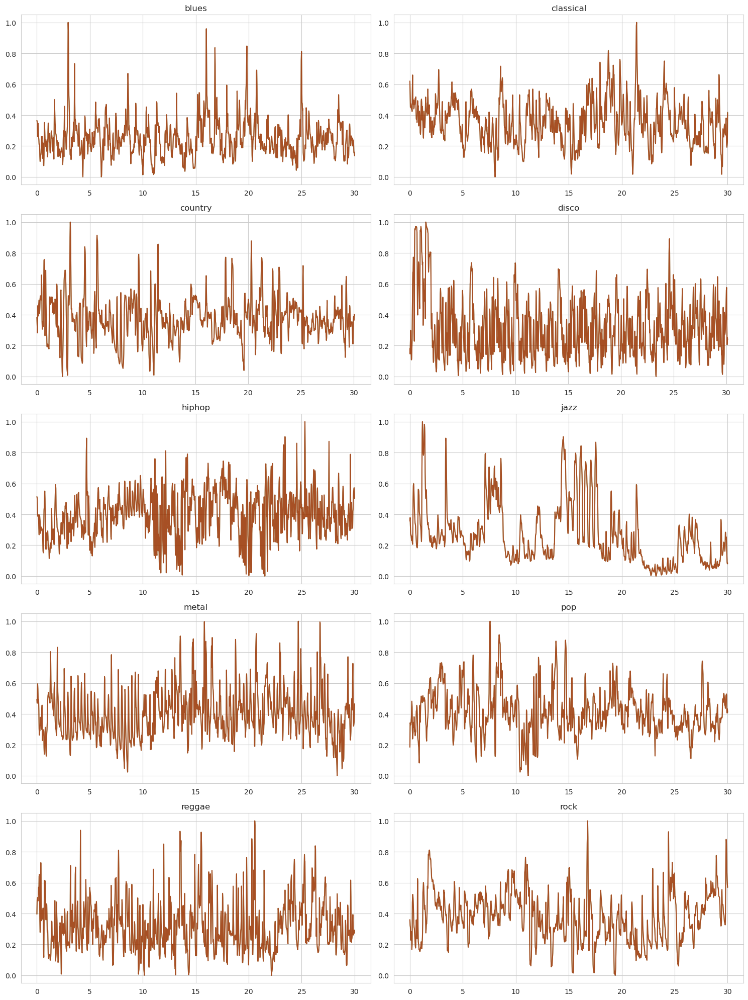

In [12]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    spectral_centroids = librosa.feature.spectral_centroid(y=data, sr=sampling_rate)[0]
    spec_bw = librosa.feature.spectral_bandwidth(y=data, sr=sampling_rate)[0]
    # Computing the time variable for visualization
    frames = range(len(spectral_centroids))
    # Converts frame counts to time (seconds)
    t = librosa.frames_to_time(frames)
    # Plotting the Spectral Centroid along the waveform
    ax.plot(t, preprocessing.minmax_scale(spectral_centroids, axis=0), color='g',alpha = 0.7)
    # Plotting the Spectral Bandwidth along the waveform
    ax.plot(t, preprocessing.minmax_scale(spectral_centroids + np.sqrt(spec_bw), axis=0), color='r',alpha = 0.3)
    ax.plot(t, preprocessing.minmax_scale(spectral_centroids - np.sqrt(spec_bw), axis=0), color='r',alpha = 0.3)
  
    ax.set_title(genre)

plt.tight_layout()
plt.show()

### Tempo and Beats
+ **Tempo:** Tempo is the speed or pace of a piece of music. It is measured in beats per minute (BPM). For example, classical music tends to have a lower tempo than rock or pop music.
+ **Beats:** Beats are a series of regular pulses that occur in music. They are the main rhythmic unit in music, and they are counted in measures or bars. The beat is what you might instinctively tap your foot to when listening to music.

In the provided graph, the red vertical lines (drawn using ax.vlines) indicate the locations of the beats in the audio signal. These lines visually represent the rhythmic pulse or the points in time where the beats occur. The tempo value, given in the title of each subplot, specifies the number of beats (pulses) occurring in one minute.

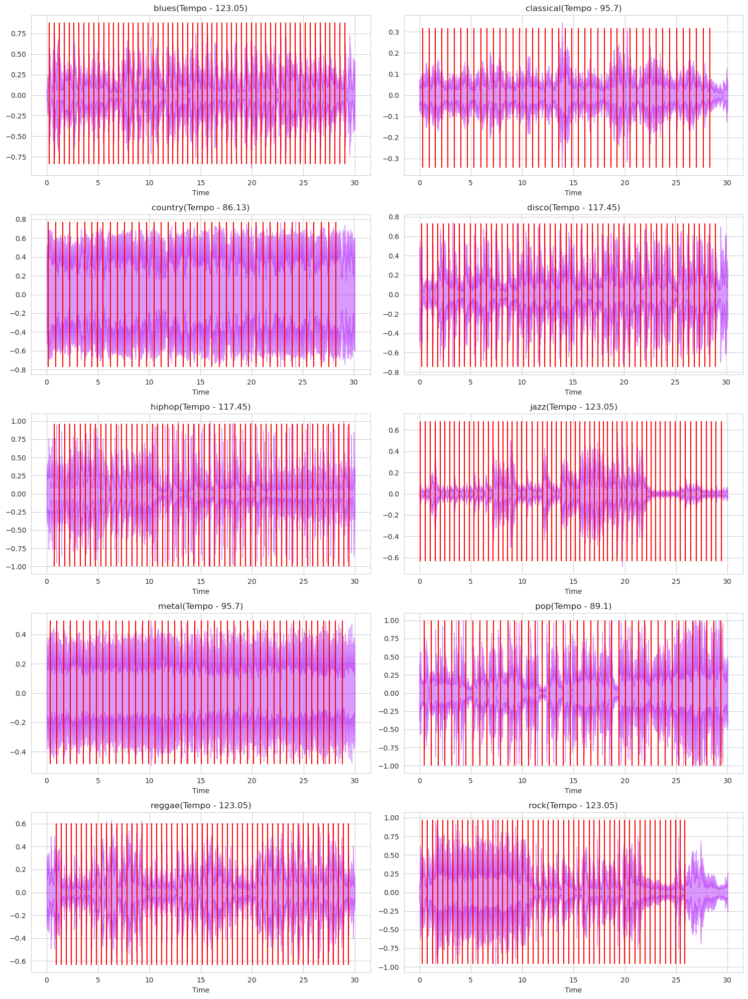

In [13]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    tempo, beat_times = librosa.beat.beat_track(y=data, sr=sampling_rate, units='time')
    librosa.display.waveshow(y = data, sr = sampling_rate, color = "#A300F9",alpha = 0.4,ax=ax)
    ax.vlines(beat_times, np.min(data), np.max(data), color='r')
    ax.set_title(genre + "(Tempo - " + str(round(tempo,2)) + ")")

plt.tight_layout()
plt.show()

### Spectral Rolloff
Spectral Rolloff characterizes the steepness or steepness of the spectral envelope of a signal. It is defined as the frequency below which a specified percentage of the total spectral energy, e.g. 85%, lies.

1. **Calculation:** Spectral rolloff is typically calculated as the frequency below which a specified percentage (often 85% or 95%) of the total spectral energy is contained. This calculation is performed on the power spectrum of the signal.

The formula for spectral rolloff is as follows:

Spectral Rolloff (SR) = Frequency below which X% of the total spectral energy is contained.

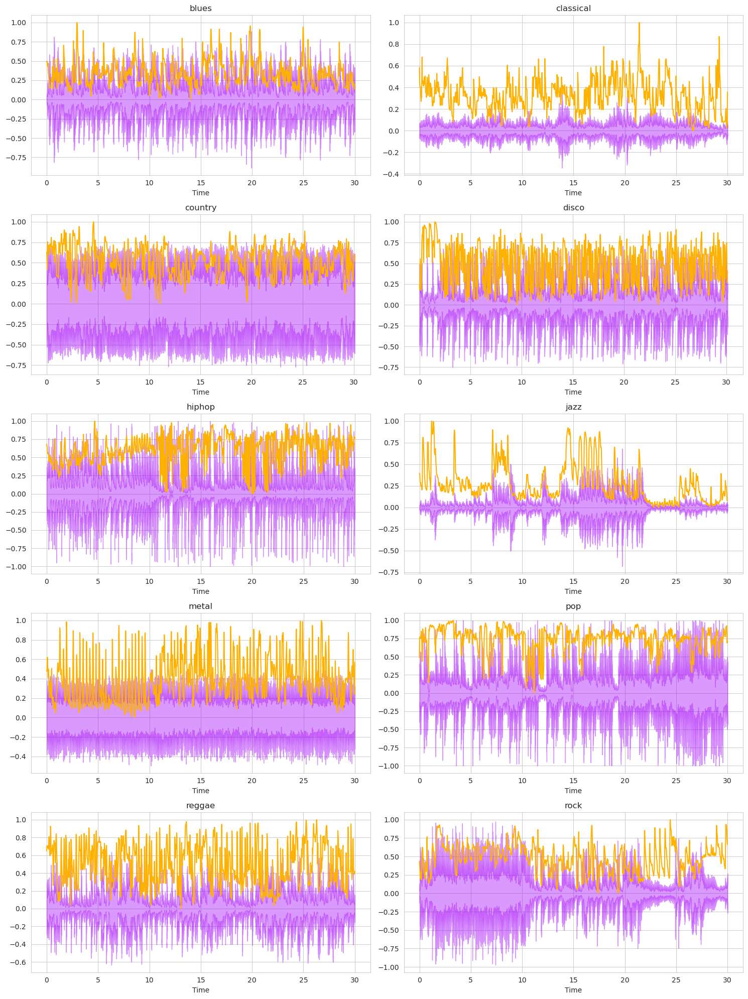

In [14]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
for (genre, _), ax in zip(genre_dict.items(), axes.flat):
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    spectral_rolloff = librosa.feature.spectral_rolloff(y=data, sr=sampling_rate)[0]
    # Computing the time variable for visualization
    frames = range(len(spectral_rolloff))
    # Converts frame counts to time (seconds)
    t = librosa.frames_to_time(frames)
    librosa.display.waveshow(data, sr=sampling_rate, alpha=0.4, color = '#A300F9',ax=ax)
    ax.plot(t, preprocessing.minmax_scale(spectral_rolloff, axis=0), color='#FFB100')
    ax.set_title(genre)

plt.tight_layout()
plt.show()

### Harmonic and Percussive Components
+ The **harmonic component** of an audio signal consists of sounds that have a tonal and pitch-like quality. It represents musical notes, chords, or any sound components that exhibit a clear fundamental frequency and harmonic overtones.
+ Harmonic sounds are typically produced by musical instruments like pianos, violins, and guitars. The harmonic component often carries the melodic and harmonic information and contributes to the musical tonality.
+ The **percussive component** of an audio signal includes non-tonal and transient sounds. These sounds are typically short-lived and characterized by percussive or transient characteristics.
Examples of percussive sounds include drum hits, claps, and other sound events that lack a clear tonal pitch.
+ The percussive component often carries the rhythmic and transient information in the audio and contributes to the rhythm and groove of the music.

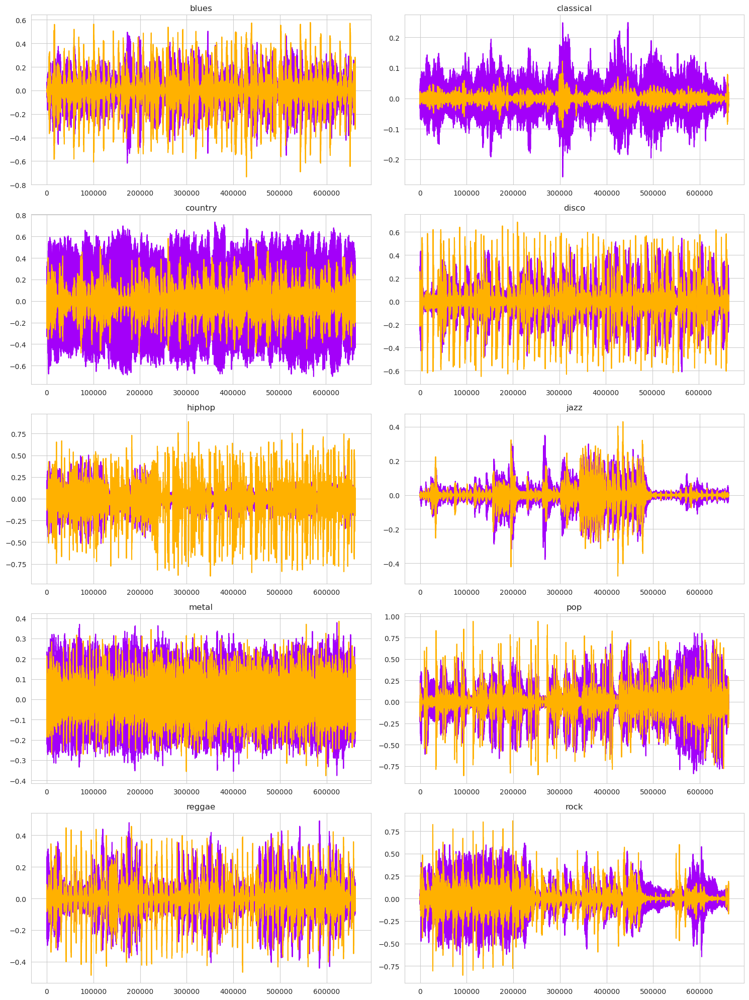

In [22]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_dict.keys():
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    y_harm, y_perc = librosa.effects.hpss(data)
    ax.plot(y_harm, color = '#A300F9')
    ax.plot(y_perc, color = '#FFB100')
    ax.set_title(genre)

plt.tight_layout()
plt.show()